# Introduction

TBC

In [1]:
#Import Modules

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import random

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

plt.style.use('ggplot')

In [24]:
# Import Datasets

df_trans = pd.read_csv('datasets/QVI_transaction_data.csv')
df_cust = pd.read_csv('datasets/QVI_purchase_behaviour.csv')

### Transaction Data Exploration

In [3]:
# Explore first 10 rows
display(df_trans.head(10))

# Check shape
display(df_trans.shape)

# Check for nulls and datatypes
display(df_trans.info())

# Understand unique values in categorical columns
display(df_trans.nunique())

,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES
0,43390,1,1000,1,5,Natural Chip Compny SeaSalt175g,2,6.0
1,43599,1,1307,348,66,CCs Nacho Cheese 175g,3,6.3
2,43605,1,1343,383,61,Smiths Crinkle Cut Chips Chicken 170g,2,2.9
3,43329,2,2373,974,69,Smiths Chip Thinly S/Cream&Onion 175g,5,15.0
4,43330,2,2426,1038,108,Kettle Tortilla ChpsHny&Jlpno Chili 150g,3,13.8
5,43604,4,4074,2982,57,Old El Paso Salsa Dip Tomato Mild 300g,1,5.1
6,43601,4,4149,3333,16,Smiths Crinkle Chips Salt & Vinegar 330g,1,5.7
7,43601,4,4196,3539,24,Grain Waves Sweet Chilli 210g,1,3.6
8,43332,5,5026,4525,42,Doritos Corn Chip Mexican Jalapeno 150g,1,3.9
9,43330,7,7150,6900,52,Grain Waves Sour Cream&Chives 210G,2,7.2


(264836, 8)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264836 entries, 0 to 264835
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DATE            264836 non-null  int64  
 1   STORE_NBR       264836 non-null  int64  
 2   LYLTY_CARD_NBR  264836 non-null  int64  
 3   TXN_ID          264836 non-null  int64  
 4   PROD_NBR        264836 non-null  int64  
 5   PROD_NAME       264836 non-null  object 
 6   PROD_QTY        264836 non-null  int64  
 7   TOT_SALES       264836 non-null  float64
dtypes: float64(1), int64(6), object(1)
memory usage: 16.2+ MB


None

DATE                 364
STORE_NBR            272
LYLTY_CARD_NBR     72637
TXN_ID            263127
PROD_NBR             114
PROD_NAME            114
PROD_QTY               6
TOT_SALES            112
dtype: int64

---
- DATE column contains 364 unique values, ranging from 43282 to 43646. Will convert these to datetime, starting from 2020/07/01
- STORE_NBR, LYLTY_CARD_NBR, TXN_ID, PROD_NBR datatype is integer, we'll convert these to Categories
---

###### Data Cleaning

In [4]:
## Replace values in DATE

# List of unique values in Date + Sort
dates = list(set(df_trans.DATE.values))
dates.sort()

# List of unique values to replace current values of DATE
replacement = list(range(1,365))

# Create dictionary
date_map = dict(zip(dates, replacement))

# Map to dateframe
df_trans['DATE'] = df_trans['DATE'].map(date_map)

# Convert to datetime - Begin 2020-07-01
df_trans['DATE'] = pd.to_datetime(df_trans['DATE'], unit='D', origin='2020-07-01')

In [5]:
## Convert STORE_NBR, LYLTY_CARD_NBR, TXN_ID, PROD_NBR to category dtype.
cols = ['STORE_NBR', 'LYLTY_CARD_NBR', 'TXN_ID', 'PROD_NBR']

for col in cols:
    df_trans[col] = df_trans[col].astype('category')


In [6]:
#Describe the data
display(df_trans.describe(include='all', datetime_is_numeric=True).T)

#data info
display(df_trans.info())

,count,unique,top,freq,mean,min,25%,50%,75%,max,std
DATE,264836,NaN,NaN,NaN,2020-12-30 12:35:23.819984128,2020-07-02 00:00:00,2020-10-01 00:00:00,2020-12-30 00:00:00,2021-03-31 00:00:00,2021-06-30 00:00:00,NaN
STORE_NBR,264836,272,226,2022,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LYLTY_CARD_NBR,264836,72637,172032,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TXN_ID,264836,263127,1162,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PROD_NBR,264836,114,102,3304,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PROD_NAME,264836,114,Kettle Mozzarella Basil & Pesto 175g,3304,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PROD_QTY,264836,NaN,NaN,NaN,1.90731,1,2,2,2,200,0.643654
TOT_SALES,264836,NaN,NaN,NaN,7.3042,1.5,5.4,7.4,9.2,650,3.08323


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264836 entries, 0 to 264835
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DATE            264836 non-null  datetime64[ns]
 1   STORE_NBR       264836 non-null  category      
 2   LYLTY_CARD_NBR  264836 non-null  category      
 3   TXN_ID          264836 non-null  category      
 4   PROD_NBR        264836 non-null  category      
 5   PROD_NAME       264836 non-null  object        
 6   PROD_QTY        264836 non-null  int64         
 7   TOT_SALES       264836 non-null  float64       
dtypes: category(4), datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 25.9+ MB


None

---
- 272 unique stores included in the dataset, with store 226 having the most amount of transactions
    - Does this store have a higher proportion of customer type than others?
- 72,637 unique loyalty cards present in the dataset
- 263,127 transaction IDs
    - Need to understand what the duplicate IDs represent
- 114 different products
- Average sale is 1.9 units
    - Looks to be an outlier of 200, will need to explore this
- Average sale price is $7.3
---

In [62]:
## Parse out packet size

# Explore column
#display(set(df_trans.PROD_NAME.values))

# Reviewing the list, we can see that all values contain the chip size, and it's either a 2 digit or 3 digit number.

df_trans['packet_size'] = df_trans.PROD_NAME.str.extract(r'(\d+)', expand=True)

In [63]:
#

df_trans.PROD_NAME.str.extract(r'(\w+$)')

,0
0,SeaSalt175g
1,175g
2,170g
3,175g
4,150g
5,300g
6,330g
7,210g
8,150g
9,210G


##### Categorical Variables - Exploration

In [8]:
## Understand duplicate TXN_IDs

# Review rows of duplicated TXN_ID
mask = df_trans.TXN_ID.duplicated(keep=False)
display(df_trans[mask].head(20))

# Check to see largest number of duplicated values
set(df_trans.TXN_ID.value_counts().values)

,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES
41,2021-05-20,55,55073,48887,4,Dorito Corn Chp Supreme 380g,1,3.25
42,2021-05-20,55,55073,48887,113,Twisties Chicken270g,1,4.60
376,2021-01-10,7,7364,7739,50,Tostitos Lightly Salted 175g,2,8.80
377,2021-01-10,7,7364,7739,20,Doritos Cheese Supreme 330g,2,11.40
418,2020-10-19,12,12301,10982,50,Tostitos Lightly Salted 175g,2,8.80
419,2020-10-19,12,12301,10982,93,Doritos Corn Chip Southern Chicken 150g,2,7.80
475,2020-09-09,16,16427,14546,99,Pringles Sthrn FriedChicken 134g,1,3.70
476,2020-09-09,16,16427,14546,81,Pringles Original Crisps 134g,1,3.70
510,2020-08-04,19,19272,16683,7,Smiths Crinkle Original 330g,2,11.40
511,2020-08-04,19,19272,16683,31,Infzns Crn Crnchers Tangy Gcamole 110g,2,7.60


{1, 2, 3}

Seems as though if a customer purchases different chip packets, it's recorded under the same transaction ID, though on a different row. Based on this it appears that based on this dataset a customer won't purchase more than 3 variations of chip packets in a single transaction.

---

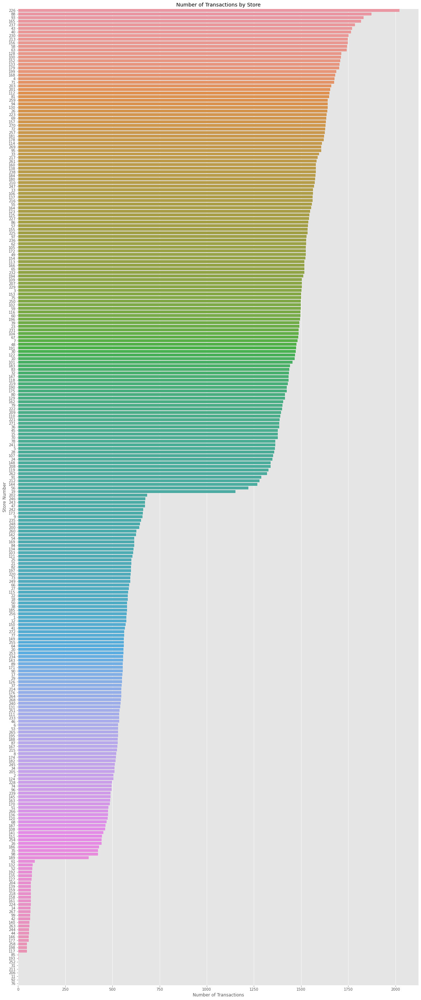

In [9]:
## STORE_NBR

# Groupby Stores
df_grouped = df_trans.groupby('STORE_NBR').agg({'TXN_ID': 'count'}).reset_index()

# Visualisation

fig, ax = plt.subplots(figsize=(20,50))

sns.barplot(data=df_grouped, y='STORE_NBR', x='TXN_ID', ax=ax,
           order=df_grouped.sort_values('TXN_ID', ascending=False).STORE_NBR)

ax.set_title('Number of Transactions by Store')
ax.set_ylabel('Store Number')
ax.set_xlabel('Number of Transactions')

plt.show()

We can roughly group the stores into 3-4 categories, which can be characterised by the steep drop offs. This may be indicative of the size or location of each of the stores. 

##### Numerical Variables - Exploration

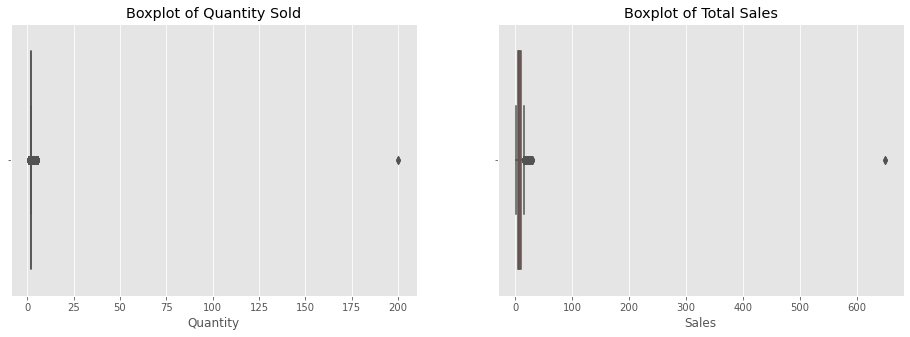

In [10]:
# Numerical Variables - Visualisations

fig, ax = plt.subplots(1,2,figsize=(16,5))

# PROD_QTY
sns.boxplot(data=df_trans, x='PROD_QTY', ax=ax[0])
ax[0].set_title('Boxplot of Quantity Sold')
ax[0].set_xlabel('Quantity')

# TOT_SALES
sns.boxplot(data=df_trans, x='TOT_SALES', ax=ax[1])
ax[1].set_title('Boxplot of Total Sales')
ax[1].set_xlabel('Sales')

plt.show()

There is clearly an outlier from the visuals above, we'll first investigate these rows, and make a decision on what to do from there.

In [11]:
# Check rows with outliers
display(df_trans[df_trans.PROD_QTY > 50])

,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES
69762,2020-08-20,226,226000,226201,4,Dorito Corn Chp Supreme 380g,200,650.0
69763,2021-05-20,226,226000,226210,4,Dorito Corn Chp Supreme 380g,200,650.0


This looks to be for the same customer on two different occasions. We can assume this unusual purchase may have been for commerical purposes, and can be removed for the purpose of this analysis, as we're concerned on retail customers.

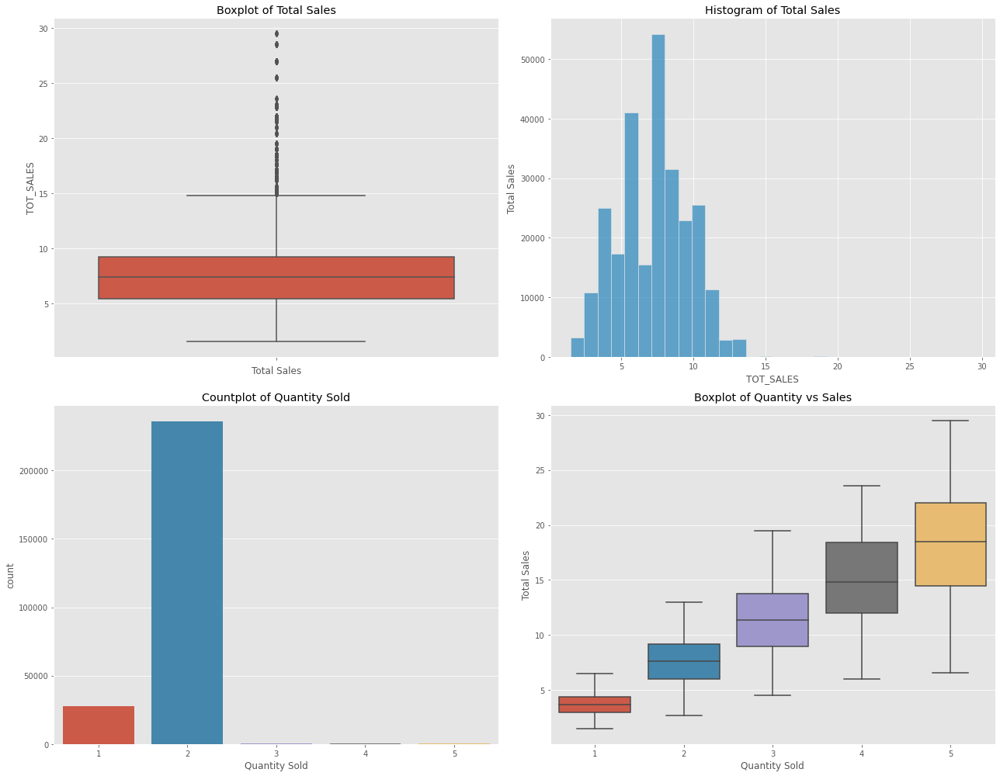

In [12]:
# Filter out outliers
df_trans = df_trans[df_trans.PROD_QTY < 50]

# Re-run visuals
fig, ax = plt.subplots(2,2,figsize=(18,14))

# TOT_SALES
sns.boxplot(data=df_trans, y='TOT_SALES', ax=ax[0,0])
ax[0,0].set_title('Boxplot of Total Sales')
ax[0,0].set_xlabel('Total Sales')

sns.histplot(data=df_trans, x='TOT_SALES', ax=ax[0,1], bins=30)
ax[0,1].set_title('Histogram of Total Sales')
ax[0,1].set_ylabel('Total Sales')

# PROD_QTY
sns.countplot(data=df_trans, x='PROD_QTY', ax=ax[1,0])
ax[1,0].set_title('Countplot of Quantity Sold')
ax[1,0].set_xlabel('Quantity Sold')

# PROD_QTY vs TOT_SALES
sns.boxplot(data=df_trans, x='PROD_QTY', y='TOT_SALES', ax=ax[1,1])
ax[1,1].set_title('Boxplot of Quantity vs Sales')
ax[1,1].set_xlabel('Quantity Sold')
ax[1,1].set_ylabel('Total Sales')

plt.tight_layout()
plt.show()

- Half of the transactions had total sales between $5.4 and \\$9.2. 
- Most customers would purchase 2 chip packets per transaction
- We see higher variance in total sales, as the quantity of chips sold increases

In [13]:
##TODO:

# Understand Date column
# Create Time Series 
# Parse out Brand Names
# Parse out packet size

In [14]:
## Questions:

# Which stores have the highest total sales

#### Customer Data Exploration

In [15]:
# Explore first 10 rows
df_cust.head(10)

,LYLTY_CARD_NBR,LIFESTAGE,PREMIUM_CUSTOMER
0,1000,YOUNG SINGLES/COUPLES,Premium
1,1002,YOUNG SINGLES/COUPLES,Mainstream
2,1003,YOUNG FAMILIES,Budget
3,1004,OLDER SINGLES/COUPLES,Mainstream
4,1005,MIDAGE SINGLES/COUPLES,Mainstream
5,1007,YOUNG SINGLES/COUPLES,Budget
6,1009,NEW FAMILIES,Premium
7,1010,YOUNG SINGLES/COUPLES,Mainstream
8,1011,OLDER SINGLES/COUPLES,Mainstream
9,1012,OLDER FAMILIES,Mainstream
